#  Seam Carving

## Basic Implementation

In [1]:
## import prerequisites 
import cv2
import numpy as np
import seam_carving
from pathlib import Path
from seam_carving import resize, remove_object, poisson_wrapper
import matplotlib.pyplot as plt
import matplotlib.gridspec as grd
%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.rcParams["font.family"] = "Times New Roman"

def show_and_save_images(imglist, captions=None, filenames=None, zoom=1, fontsize=18, hspace=0.1, use_raw=False):
    if type(imglist) is not list:
        imglist = [imglist]
    if filenames is None:
        filenames = [None for _ in range(len(imglist))]
    if type(filenames) is not list:
        filenames = [filenames]
    assert len(imglist) == len(filenames)
    n = len(imglist)
    if captions is not None:
        if type(captions) is not list:
            captions = [captions]
        assert len(captions) == n
    first_img = imglist[0]
    dpi = 77
    fig = plt.figure(figsize=(first_img.shape[1]*n*zoom/dpi, first_img.shape[0]*zoom/dpi))
    gs = grd.GridSpec(1, n, wspace=0.02)
    # fig, axes = plt.subplots(1, n, sharey=True, figsize=(first_img.shape[1]*n*zoom/dpi,first_img.shape[0]*zoom/dpi))
    for i in range(0, n):
        img = imglist[i]
        ax = plt.subplot(gs[i])
        if img.shape[0] == first_img.shape[0]:
            iimg = img
        elif img.shape[1] == first_img.shape[1] and img.shape[0] < first_img.shape[0]:
            new_shape = list(img.shape)
            new_shape[0] = first_img.shape[0]
            coeff = 255 if img.dtype == np.uint8 else 0
            iimg = np.ones(new_shape, dtype=img.dtype) * coeff
            iimg[-img.shape[0]:] = img
        else:
            iimg = img
        if captions is not None:
            ax.set_title(captions[i], y=-hspace, fontsize=fontsize)
        ax.axis('off')
        if not use_raw:
            if iimg.ndim == 2:
                img = np.repeat(iimg[:,:,np.newaxis], 3, 2)
            iimg = cv2.cvtColor(iimg, cv2.COLOR_BGR2RGB)
        ax.imshow(iimg, interpolation='nearest')
        ax.set_aspect('equal')
        if filenames[i]:
            cv2.imwrite(str(filenames[i]), img)
            
def read_img(path):
    img = cv2.imread(str(path))
    assert img is not None
    print(f"Img shape: {img.shape}", flush=True)
    return img

def read_mask(path):
    img = cv2.imread(str(path), 0)
    assert img is not None
    print(f"Mask shape: {img.shape}", flush=True)
    return img > 200
    
def resize_with_seam(src, size, energy, **kwargs):
    h, w = src.shape[:2]
    indices = seam_carving._gen_idx_mat((h, w))
    dst, indices = resize([src, indices], size, energy, **kwargs)
    mask = seam_carving._mask_from_indices((h, w), indices)
    seam = src.copy()
    seam[~mask] = [0, 255, 255]
    return dst, seam

SRC_DIR = Path('../demo/orig')
DST_DIR = Path('../demo/output')

cvt = lambda img: cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

### Horizontal resizing

Img shape: (407, 600, 3)


100%|██████████| 193/193 [00:02<00:00, 70.82it/s]


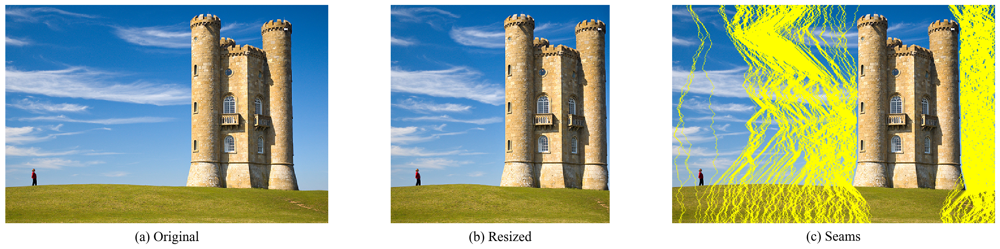

In [2]:
img = read_img(SRC_DIR / 'castle.jpg')
dst, seam = resize_with_seam(img, (407, 407), 'backward')
show_and_save_images([img, dst, seam], captions=['(a) Original', '(b) Resized', '(c) Seams'])

### Horizontal resizing (failure case)

When source image is kind of *crowded*, seam carving may yield undesirable effects.

Img shape: (667, 1000, 3)


100%|██████████| 333/333 [00:08<00:00, 39.49it/s]


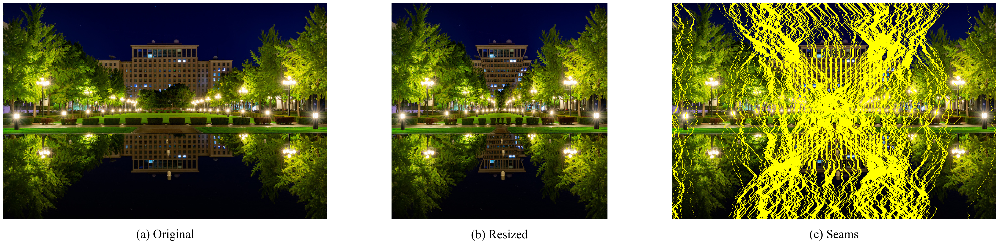

In [3]:
img = read_img(SRC_DIR / 'mbuilding_night.jpg')
dst, seam = resize_with_seam(img, (667, 667), 'backward')
show_and_save_images([img, dst, seam], captions=['(a) Original', '(b) Resized', '(c) Seams'], fontsize=27)

Img shape: (667, 1000, 3)


100%|██████████| 333/333 [00:29<00:00, 11.13it/s]


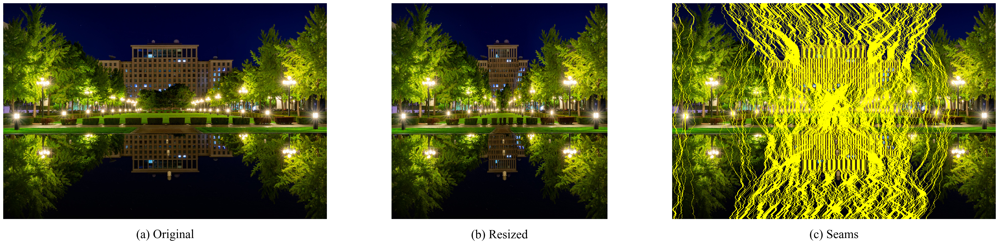

In [4]:
img = read_img(SRC_DIR / 'mbuilding_night.jpg')
dst, seam = resize_with_seam(img, (667, 667), 'forward')
show_and_save_images([img, dst, seam], captions=['(a) Original', '(b) Resized', '(c) Seams'], fontsize=27)

### Vertical resizing

Img shape: (738, 486, 3)


100%|██████████| 252/252 [00:04<00:00, 61.67it/s]


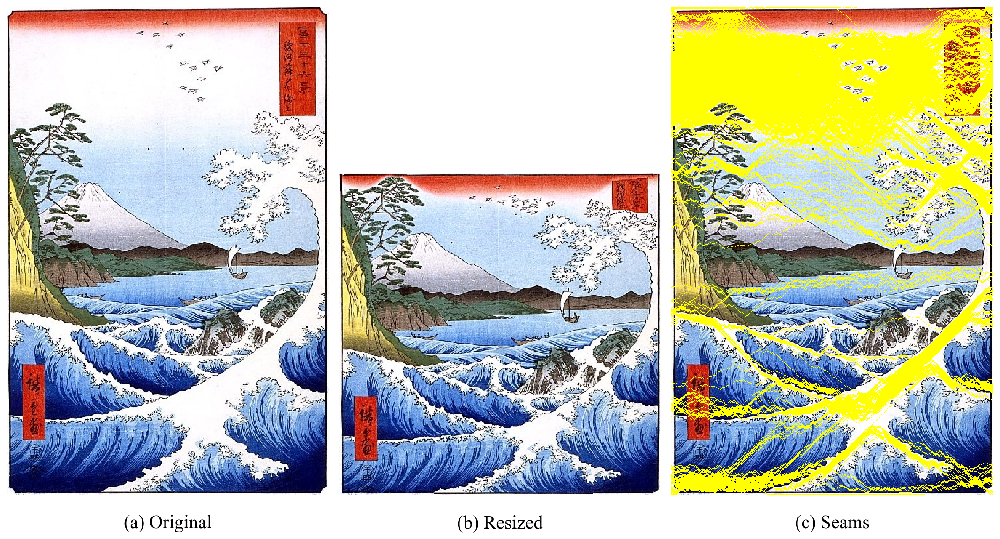

In [5]:
img = read_img(SRC_DIR / 'fuji.jpg')
dst, seam = resize_with_seam(img, (486, 486), 'backward')
show_and_save_images([img, dst, seam], captions=['(a) Original', '(b) Resized', '(c) Seams'], fontsize=20, hspace=0.08)

## Different Energy funcs



In [6]:
src = read_img(SRC_DIR / 'charles.jpg')
gray = seam_carving.bgr2gray(src)
target_size = (300, 400)
legend = ['(a) Energy', '(b) Accumulated Energy', '(c) Result']

Img shape: (500, 400, 3)


### Gradient Energy

100%|██████████| 200/200 [00:02<00:00, 90.88it/s] 


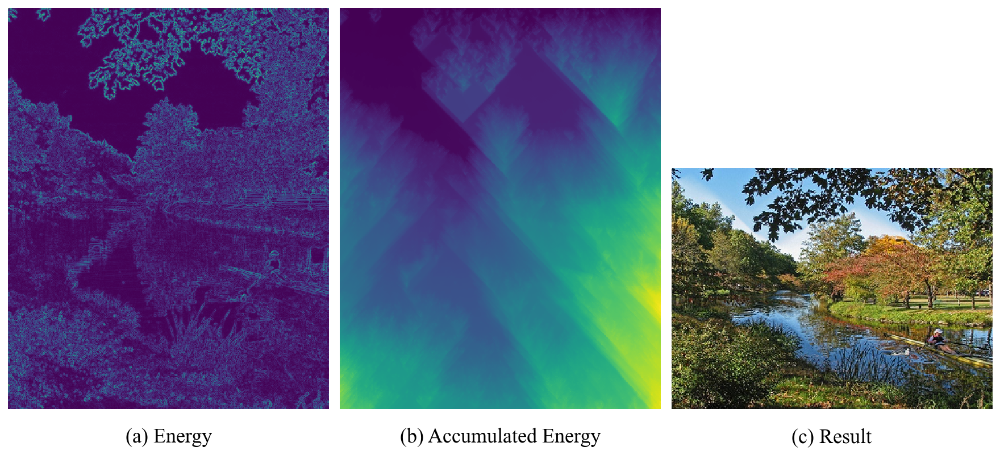

In [7]:
energy_back = seam_carving.get_energy(gray, 'backward')
accu_back = seam_carving.accumulate_energy(energy_back)
carved_back = cvt(seam_carving.resize(src, target_size, 'backward'))
show_and_save_images([energy_back, accu_back, carved_back], legend, use_raw=True)

### Entropy

In [8]:
energy_ent = seam_carving.get_energy(gray, 'entropy')
accu_ent = seam_carving.accumulate_energy(energy_ent)
carved_ent = cvt(seam_carving.resize(src, target_size, 'entropy'))
%store energy_ent
%store accu_ent
%store carved_ent

100%|██████████| 200/200 [00:47<00:00,  4.19it/s]

Stored 'energy_ent' (ndarray)
Stored 'accu_ent' (ndarray)
Stored 'carved_ent' (ndarray)


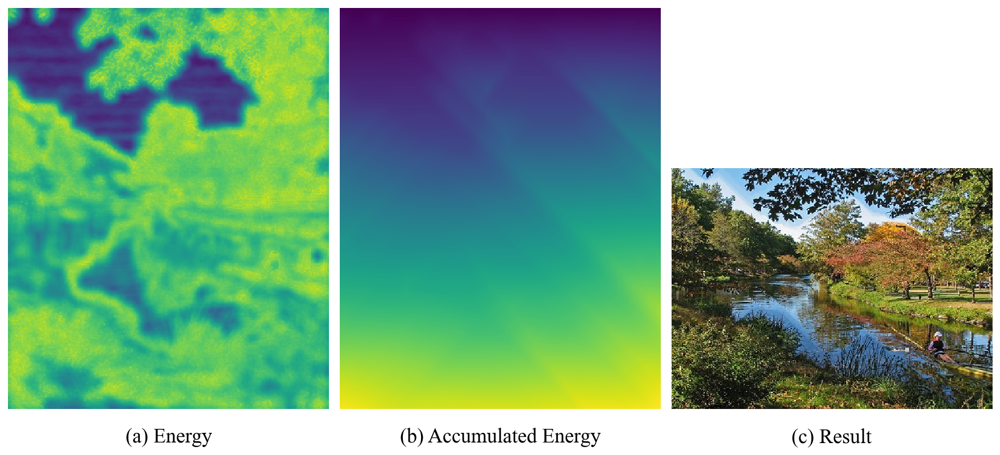

In [9]:
%store -r energy_ent
%store -r accu_ent
%store -r carved_ent
show_and_save_images([energy_ent, accu_ent, carved_ent], legend, use_raw=True)

### HoG (Histogram of Oriented Gradients)

In [10]:
energy_hog = seam_carving.get_energy(gray, 'hog')
accu_hog = seam_carving.accumulate_energy(energy_hog)
carved_hog = cvt(seam_carving.resize(src, target_size, 'hog'))
%store energy_hog
%store accu_hog
%store carved_hog

100%|██████████| 200/200 [15:40<00:00,  4.70s/it]

Stored 'energy_hog' (ndarray)
Stored 'accu_hog' (ndarray)
Stored 'carved_hog' (ndarray)


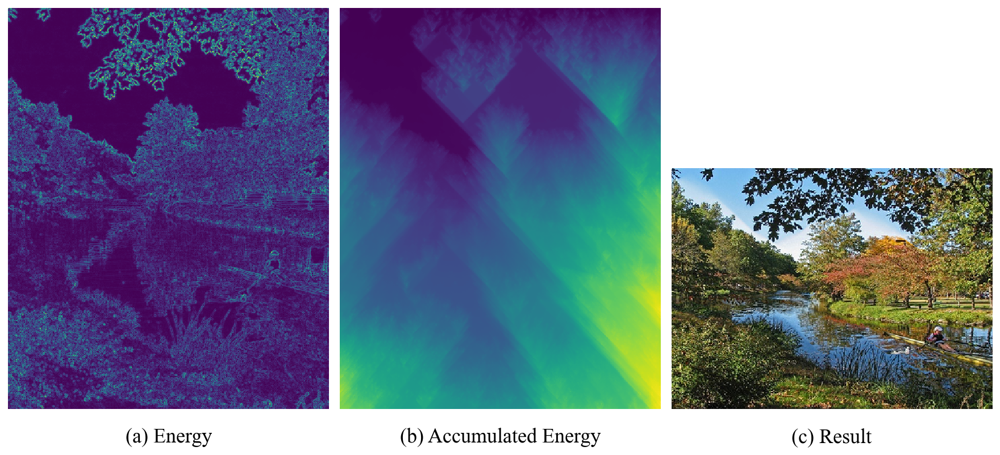

In [11]:
%store -r energy_hog
%store -r accu_hog
%store -r carved_hog
show_and_save_images([energy_hog, accu_hog, carved_hog], legend, use_raw=True)

### Forward Energy

100%|██████████| 200/200 [00:07<00:00, 27.38it/s]


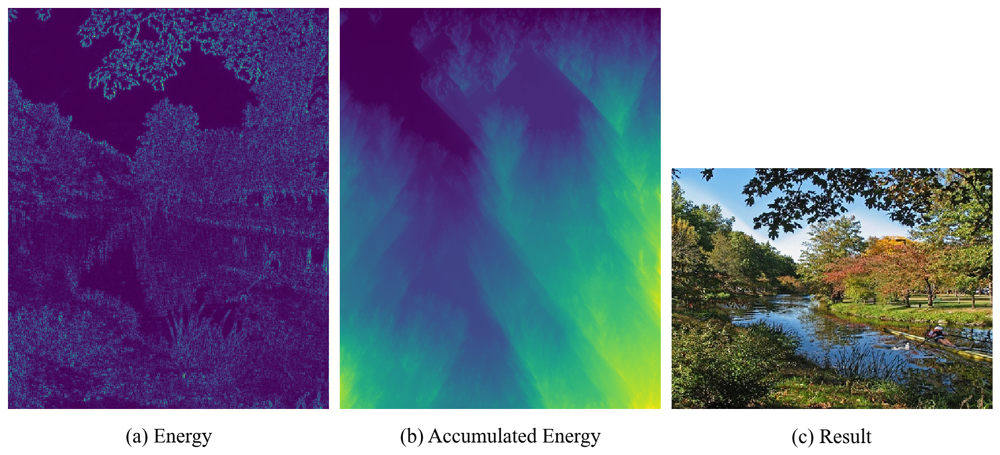

In [12]:
energy = seam_carving.get_energy(gray, 'forward')
accu = seam_carving.accumulate_energy(energy)
carved = cvt(seam_carving.resize(src, target_size, 'forward'))
show_and_save_images([energy, accu, carved], legend, use_raw=True)

## Forward vs Backward Energy

In [13]:
src = read_img(SRC_DIR / 'bench.jpg')
gray = seam_carving.bgr2gray(src)

Img shape: (342, 512, 3)


100%|██████████| 170/170 [00:01<00:00, 114.34it/s]


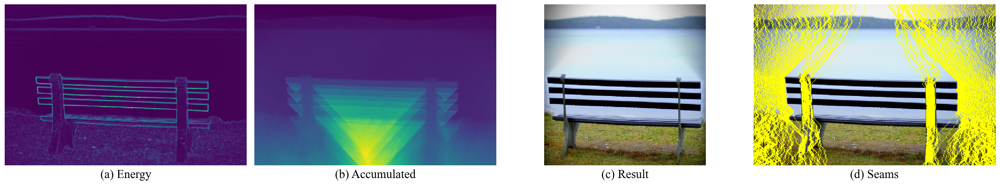

In [14]:
energy = seam_carving.get_energy(gray, 'backward')
accu = seam_carving.accumulate_energy(energy)
dst, seam = resize_with_seam(src, (342, 342), 'backward')
show_and_save_images([energy, accu, cvt(dst), cvt(seam)], captions=['(a) Energy', '(b) Accumulated', '(c) Result', '(d) Seams'], use_raw=True)

100%|██████████| 170/170 [00:05<00:00, 32.73it/s]


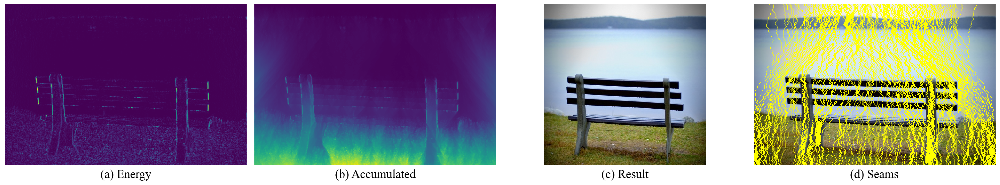

In [15]:
energy = seam_carving.get_energy(gray, 'forward')
accu = seam_carving.accumulate_energy(energy)
dst, seam = resize_with_seam(src, (342, 342), 'forward')
show_and_save_images([energy, accu, cvt(dst), cvt(seam)], captions=['(a) Energy', '(b) Accumulated', '(c) Result', '(d) Seams'], use_raw=True)

## Optimized order for seam deletion

In [16]:
src = read_img(SRC_DIR / 'flower.jpg')

Img shape: (400, 600, 3)


In [17]:
seam_path, dp = seam_carving._resize_optimal_impl(src, -50, -50, 'forward')

100%|██████████| 2601/2601 [03:53<00:00, 11.12it/s]


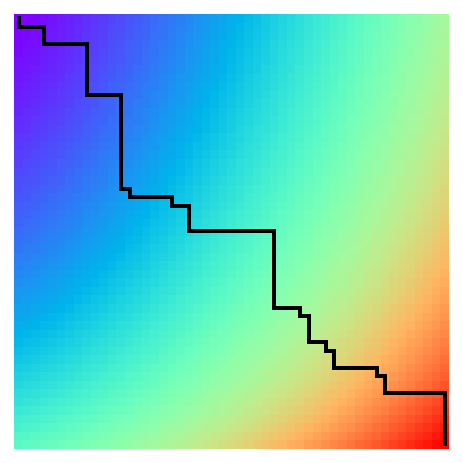

In [18]:
fig, ax = plt.subplots()
ax.imshow(dp, cmap=plt.get_cmap('rainbow'))
ax.axis('off')
h, w = dp.shape[:2]
px, py = 0, 0

HORIZ = 0
VERT = 1
for p in seam_path:
    if p == HORIZ:
        npx, npy = px, py + 1
    else:
        npx, npy = px + 1, py
    ax.plot([px, npx], [py, npy], '-', linewidth=2, color='black')
    px, py = npx, npy

In [19]:
dst = resize(src, (src.shape[0]-50, src.shape[1]-50), 'forward', order='optimal')

100%|██████████| 100/100 [00:05<00:00, 18.60it/s]


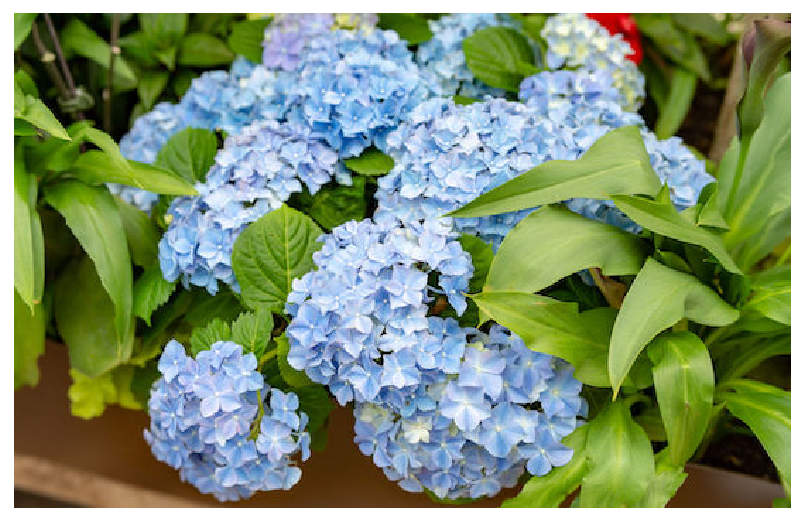

In [20]:
show_and_save_images(dst)

## Object Removal/Protection, Poisson Solver

In [21]:
src = read_img(SRC_DIR / 'zootopia.jpg')
remove = read_mask(SRC_DIR / 'zootopia_remove.jpg')
protect_full = read_mask(SRC_DIR / 'zootopia_protect_full.jpg')

Img shape: (853, 1280, 3)
Mask shape: (853, 1280)
Mask shape: (853, 1280)


In [22]:
plain = seam_carving.remove_object(src, 'forward', remove, protect_full)
poisson = seam_carving.poisson_wrapper(seam_carving.remove_object)(src, 'forward', remove, protect_full)

100%|██████████| 82043/82043 [00:28<00:00, 2854.77it/s]


Fix boundary condition for Poisson
Build coefficient matrix done, start solving poisson equation
Solve done!


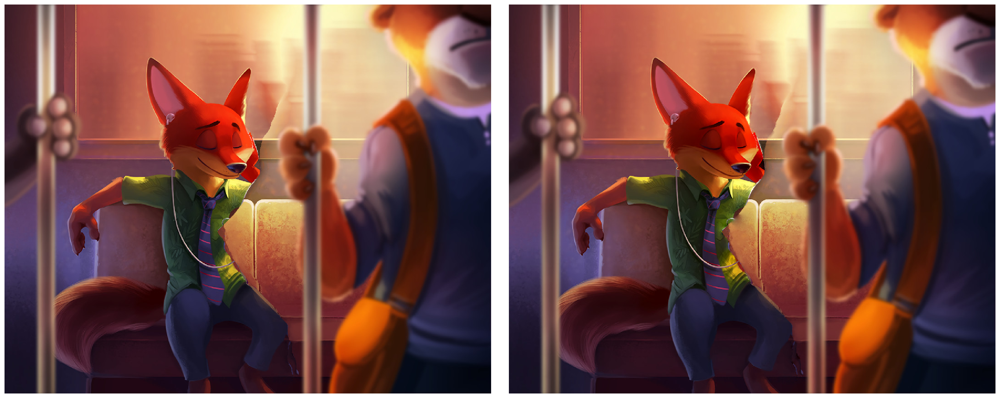

In [23]:
show_and_save_images([plain, poisson])